# 1. Importing Libraries

In [ ]:
!pip install numerize

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import pandas as pd
from numerize import numerize
import time
import warnings
warnings.filterwarnings('ignore')

# 2. First Look at the Data

In [ ]:
#first Look
df = pd.read_csv('creditcard_2023.csv', on_bad_lines='skip')
df.head()

,id,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0,-0.260648,-0.469648,2.496266,-0.083724,0.129681,0.732898,0.519014,-0.130006,0.727159,...,-0.110552,0.217606,-0.134794,0.165959,0.126280,-0.434824,-0.081230,-0.151045,17982.10,0
1,1,0.985100,-0.356045,0.558056,-0.429654,0.277140,0.428605,0.406466,-0.133118,0.347452,...,-0.194936,-0.605761,0.079469,-0.577395,0.190090,0.296503,-0.248052,-0.064512,6531.37,0
2,2,-0.260272,-0.949385,1.728538,-0.457986,0.074062,1.419481,0.743511,-0.095576,-0.261297,...,-0.005020,0.702906,0.945045,-1.154666,-0.605564,-0.312895,-0.300258,-0.244718,2513.54,0
3,3,-0.152152,-0.508959,1.746840,-1.090178,0.249486,1.143312,0.518269,-0.065130,-0.205698,...,-0.146927,-0.038212,-0.214048,-1.893131,1.003963,-0.515950,-0.165316,0.048424,5384.44,0
4,4,-0.206820,-0.165280,1.527053,-0.448293,0.106125,0.530549,0.658849,-0.212660,1.049921,...,-0.106984,0.729727,-0.161666,0.312561,-0.414116,1.071126,0.023712,0.419117,14278.97,0


The dataframe has 31 columns (features)

In [ ]:
#Data Information
df = df.dropna()
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568630 entries, 0 to 568629
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   id      568630 non-null  int64  
 1   V1      568630 non-null  float64
 2   V2      568630 non-null  float64
 3   V3      568630 non-null  float64
 4   V4      568630 non-null  float64
 5   V5      568630 non-null  float64
 6   V6      568630 non-null  float64
 7   V7      568630 non-null  float64
 8   V8      568630 non-null  float64
 9   V9      568630 non-null  float64
 10  V10     568630 non-null  float64
 11  V11     568630 non-null  float64
 12  V12     568630 non-null  float64
 13  V13     568630 non-null  float64
 14  V14     568630 non-null  float64
 15  V15     568630 non-null  float64
 16  V16     568630 non-null  float64
 17  V17     568630 non-null  float64
 18  V18     568630 non-null  float64
 19  V19     568630 non-null  float64
 20  V20     568630 non-null  float64
 21  V21     56

* There are 568630 data points in total
* All but two columns in the dataframe are of datatype float and the remaining are integer datatype

In [ ]:
#Data staticstics
df.describe()

,id,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,568630.000000,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,...,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,5.686300e+05,568630.000000,568630.0
mean,284314.500000,-5.638058e-17,-1.323544e-16,-3.518788e-17,-2.879008e-17,7.197521e-18,-3.838678e-17,-3.198898e-17,2.069287e-17,9.116859e-17,...,4.758361e-17,5.398140e-18,5.395017e-18,-1.999311e-18,-3.028957e-17,-7.547400e-18,-3.598760e-17,2.499139e-17,12041.957635,0.5
std,164149.486121,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,...,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,1.000001e+00,6919.644449,0.5
min,0.000000,-3.495584e+00,-4.996657e+01,-3.183760e+00,-4.951222e+00,-9.952786e+00,-2.111111e+01,-4.351839e+00,-1.075634e+01,-3.751919e+00,...,-1.938252e+01,-7.734798e+00,-3.029545e+01,-4.067968e+00,-1.361263e+01,-8.226969e+00,-1.049863e+01,-3.903524e+01,50.010000,0.0
25%,142157.250000,-5.652859e-01,-4.866777e-01,-6.492987e-01,-6.560203e-01,-2.934955e-01,-4.458712e-01,-2.835329e-01,-1.922572e-01,-5.687446e-01,...,-1.664408e-01,-4.904892e-01,-2.376289e-01,-6.515801e-01,-5.541485e-01,-6.318948e-01,-3.049607e-01,-2.318783e-01,6054.892500,0.0
50%,284314.500000,-9.363846e-02,-1.358939e-01,3.528579e-04,-7.376152e-02,8.108788e-02,7.871758e-02,2.333659e-01,-1.145242e-01,9.252647e-02,...,-3.743065e-02,-2.732881e-02,-5.968903e-02,1.590123e-02,-8.193162e-03,-1.189208e-02,-1.729111e-01,-1.392973e-02,12030.150000,0.5
75%,426471.750000,8.326582e-01,3.435552e-01,6.285380e-01,7.070047e-01,4.397368e-01,4.977881e-01,5.259548e-01,4.729905e-02,5.592621e-01,...,1.479787e-01,4.638817e-01,1.557153e-01,7.007374e-01,5.500147e-01,6.728879e-01,3.340230e-01,4.095903e-01,18036.330000,1.0
max,568629.000000,2.229046e+00,4.361865e+00,1.412583e+01,3.201536e+00,4.271689e+01,2.616840e+01,2.178730e+02,5.958040e+00,2.027006e+01,...,8.087080e+00,1.263251e+01,3.170763e+01,1.296564e+01,1.462151e+01,5.623285e+00,1.132311e+02,7.725594e+01,24039.930000,1.0


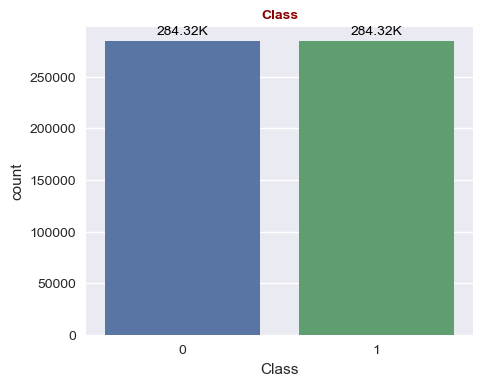

In [ ]:
fig,ax = plt.subplots(figsize = (5,4))
sns.countplot(df, x = "Class", ax = ax)

for rect in ax.patches:
    height = rect.get_height()
    ax.annotate(text = f"{numerize.numerize(height)}",
               xy = (rect.get_x()+rect.get_width()/2, height),
               xytext = (0,3),
               textcoords = "offset points",
               ha = "center",
               va = "bottom",
               color = "black")
ax.set_title("Class", fontsize = 10, fontweight = "bold", color = "darkred")
fig.show()

****Class is perfectly balanced****

# 3. Data Cleaning

* there aren't any missing values in the dataset
* all dtypes seem to be ideal



In [ ]:
#check if there are any Duplicate values
df.duplicated().any()

False

**Observation**

* There are no duplicates
* The dataset seems to be clean

# 4. EDA

## 4.1 Correlation Heatmap

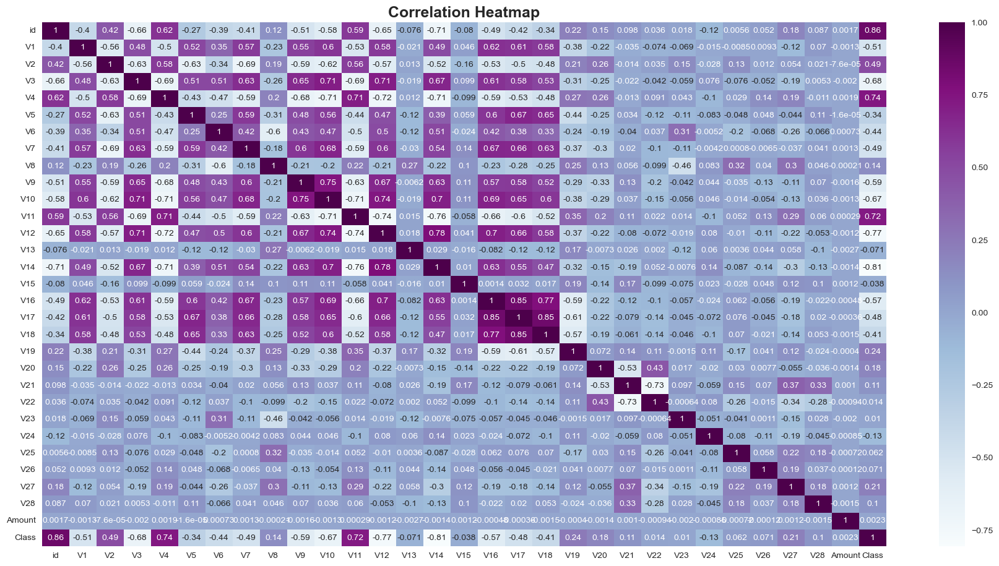

In [ ]:
plt.style.use("seaborn")

plt.rcParams['figure.figsize']= (22,11)

title = "Correlation Heatmap"

plt.title(title,fontsize=18, weight= 'bold')

sns.heatmap(df.corr(), cmap="BuPu", annot=True)

plt.show()

**Observation**

* the most significant *strong positive correlations* are between **V16 - V17 - V18** and between **V9 - V10**
* the most significant *strong negetive correlations* are between **V4 - V14** || **V4 - V12** || **V4 - V10** || **V10 - V11** || **V11 - V14** || **V11 - V12** || **V21 - V22**
* there is clear lack of h-positive correlations in the range of **V19 to V28**
* there are several moderate to semi-strong positive/negetive correlations in the range of **V1 to V18**

## 4.2 'Amount' distributaion

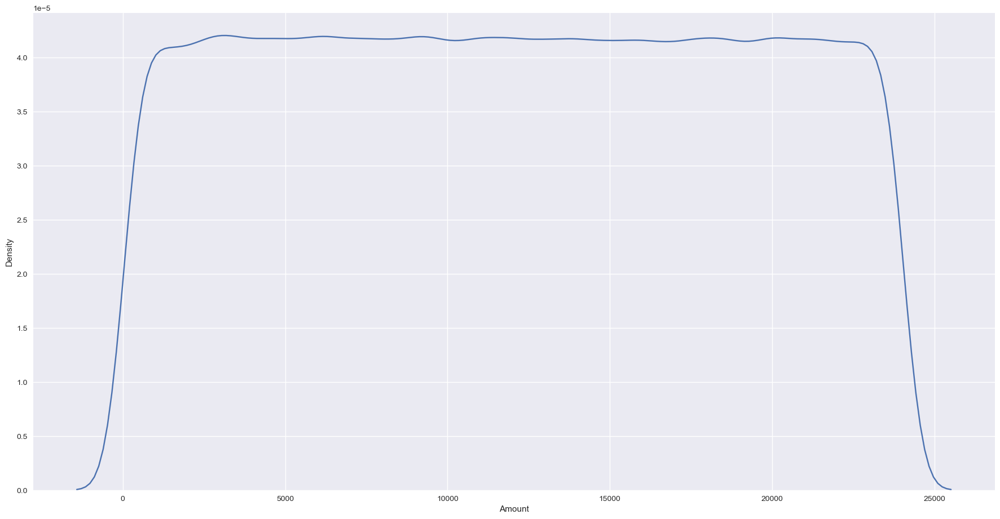

In [ ]:
sns.kdeplot(data=df['Amount'])
plt.show()

**Observation**

The 'Amount' is normaly distributed

# 5. Data Prepration

## 5.1 Defining X and target values (Y)

In [ ]:
# Dividing the dataset to features and labels
x= df.drop(['id', 'Class'], axis= 1)
y= df['Class']

In [ ]:
x.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
0,-0.260648,-0.469648,2.496266,-0.083724,0.129681,0.732898,0.519014,-0.130006,0.727159,0.637735,...,0.091202,-0.110552,0.217606,-0.134794,0.165959,0.126280,-0.434824,-0.081230,-0.151045,17982.10
1,0.985100,-0.356045,0.558056,-0.429654,0.277140,0.428605,0.406466,-0.133118,0.347452,0.529808,...,-0.233984,-0.194936,-0.605761,0.079469,-0.577395,0.190090,0.296503,-0.248052,-0.064512,6531.37
2,-0.260272,-0.949385,1.728538,-0.457986,0.074062,1.419481,0.743511,-0.095576,-0.261297,0.690708,...,0.361652,-0.005020,0.702906,0.945045,-1.154666,-0.605564,-0.312895,-0.300258,-0.244718,2513.54
3,-0.152152,-0.508959,1.746840,-1.090178,0.249486,1.143312,0.518269,-0.065130,-0.205698,0.575231,...,-0.378223,-0.146927,-0.038212,-0.214048,-1.893131,1.003963,-0.515950,-0.165316,0.048424,5384.44
4,-0.206820,-0.165280,1.527053,-0.448293,0.106125,0.530549,0.658849,-0.212660,1.049921,0.968046,...,0.247237,-0.106984,0.729727,-0.161666,0.312561,-0.414116,1.071126,0.023712,0.419117,14278.97


In [ ]:
y.shape

(568630,)

## 5.2 Feature Scaling

In [ ]:
# numerical attribute 'Amount' has a very different scales
# Applying StandardScaler to all features

from sklearn.preprocessing import StandardScaler

In [ ]:
stn_scaler = StandardScaler()

x_scaled = stn_scaler.fit_transform(x)

In [ ]:
# Coverting x array back to dataframe

X = pd.DataFrame(x_scaled,columns=x.columns)

In [ ]:
# 'Amount' is scaled
X.head()

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
0,-0.260648,-0.469648,2.496266,-0.083724,0.129681,0.732898,0.519014,-0.130006,0.727159,0.637735,...,0.091202,-0.110552,0.217606,-0.134794,0.165959,0.126280,-0.434824,-0.081230,-0.151045,0.858447
1,0.985100,-0.356045,0.558056,-0.429654,0.277140,0.428605,0.406466,-0.133118,0.347452,0.529808,...,-0.233984,-0.194936,-0.605761,0.079469,-0.577395,0.190090,0.296503,-0.248052,-0.064512,-0.796369
2,-0.260272,-0.949385,1.728538,-0.457986,0.074062,1.419481,0.743511,-0.095576,-0.261297,0.690708,...,0.361652,-0.005020,0.702906,0.945045,-1.154666,-0.605564,-0.312895,-0.300258,-0.244718,-1.377011
3,-0.152152,-0.508959,1.746840,-1.090178,0.249486,1.143312,0.518269,-0.065130,-0.205698,0.575231,...,-0.378223,-0.146927,-0.038212,-0.214048,-1.893131,1.003963,-0.515950,-0.165316,0.048424,-0.962119
4,-0.206820,-0.165280,1.527053,-0.448293,0.106125,0.530549,0.658849,-0.212660,1.049921,0.968046,...,0.247237,-0.106984,0.729727,-0.161666,0.312561,-0.414116,1.071126,0.023712,0.419117,0.323285


## 5.3 Spliting the data set

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True, stratify=y)

In [ ]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(454904, 29)
(113726, 29)
(454904,)
(113726,)


# 6. ML Models

## 6.1 Logestic Regression

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report

In [ ]:
log_reg= LogisticRegression()
start_time = time.time()

In [ ]:
log_reg.fit(x_train, y_train)

LogisticRegression()

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 1.6528 seconds


In [ ]:
y_pred = log_reg.predict(x_test)
y_pred

array([1, 1, 0, ..., 1, 1, 1])

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.95      0.98      0.97     56863
           1       0.98      0.95      0.96     56863

    accuracy                           0.96    113726
   macro avg       0.97      0.96      0.96    113726
weighted avg       0.97      0.96      0.96    113726



## 6.2 Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
dec_tree= DecisionTreeClassifier()
start_time = time.time()

In [ ]:
dec_tree.fit(x_train, y_train)

DecisionTreeClassifier()

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 27.1495 seconds


In [ ]:
y_pred = dec_tree.predict(x_test)
y_pred

array([1, 1, 0, ..., 1, 1, 1])

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56863
           1       1.00      1.00      1.00     56863

    accuracy                           1.00    113726
   macro avg       1.00      1.00      1.00    113726
weighted avg       1.00      1.00      1.00    113726



## 6.3 Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
rand_forest= RandomForestClassifier(n_estimators=50)
start_time = time.time()

In [ ]:
rand_forest.fit(x_train, y_train)

RandomForestClassifier(n_estimators=50)

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 116.6576 seconds


In [ ]:
y_pred = rand_forest.predict(x_test)
y_pred

array([1, 1, 0, ..., 1, 1, 1])

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56863
           1       1.00      1.00      1.00     56863

    accuracy                           1.00    113726
   macro avg       1.00      1.00      1.00    113726
weighted avg       1.00      1.00      1.00    113726



## 6.4 Nearest Neighbor

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
knn = KNeighborsClassifier()
start_time = time.time()

In [ ]:
knn.fit(x_train,y_train)

KNeighborsClassifier()

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 0.0521 seconds


In [ ]:
y_pred = knn.predict(x_test.values)
y_pred

array([1, 1, 0, ..., 1, 1, 1])

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56863
           1       1.00      1.00      1.00     56863

    accuracy                           1.00    113726
   macro avg       1.00      1.00      1.00    113726
weighted avg       1.00      1.00      1.00    113726



## 6.5 Support Vector Machines

In [ ]:
from sklearn import svm
svm_svc = svm.SVC()
start_time = time.time()

In [ ]:
svm_svc.fit(x_train, y_train)

SVC()

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 344.2559 seconds


In [ ]:
y_pred_svm = svm_svc.predict(x_test)

In [ ]:
print(classification_report(y_test, y_pred_svm))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56863
           1       1.00      1.00      1.00     56863

    accuracy                           1.00    113726
   macro avg       1.00      1.00      1.00    113726
weighted avg       1.00      1.00      1.00    113726



**Observations done before PCA**

* Logestic Regression model shows an accuracy of 0.97
* Decision Tree model shows an accuracy of 1.0
* Random Forest model shows an accuracy of 1.0
* Nearest Neighbor model shows an accuracy of 1.0
* SVM model shows an accuracy of 1.0

# 7. PCA

In [ ]:
from sklearn.decomposition import PCA

#creating a PCA object with 2 components
pca = PCA(n_components=2)

#tranforming the dataset
X_train_pca2 = pca.fit_transform(x_train)

#tranforming the dataset to 2 attributes
X_test_pca2 = pca.transform(x_test)

In [ ]:
#creating a PCA object with all the components
from sklearn.decomposition import PCA
pca = PCA(n_components=28)

#tranforming the dataset
X_train_pca28 = pca.fit_transform(x_train)

#tranforming the dataset to 10 attributes
X_test_pca28 = pca.transform(x_test)

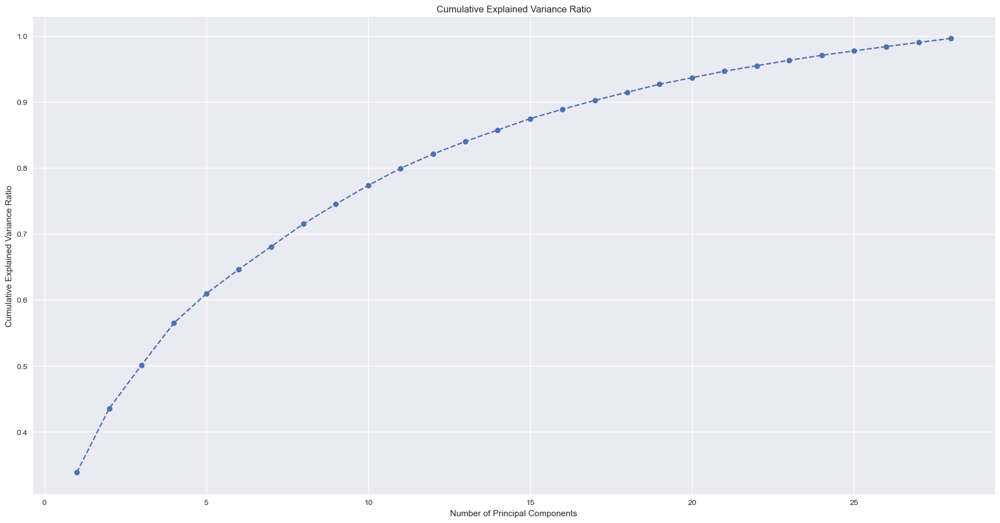

In [ ]:
import numpy as np
cumulative_variance_ratio = np.cumsum(pca.explained_variance_ratio_)

plt.plot(range(1, len(cumulative_variance_ratio) + 1), cumulative_variance_ratio, marker='o', linestyle='--')
plt.title('Cumulative Explained Variance Ratio')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.grid(True)
plt.show()

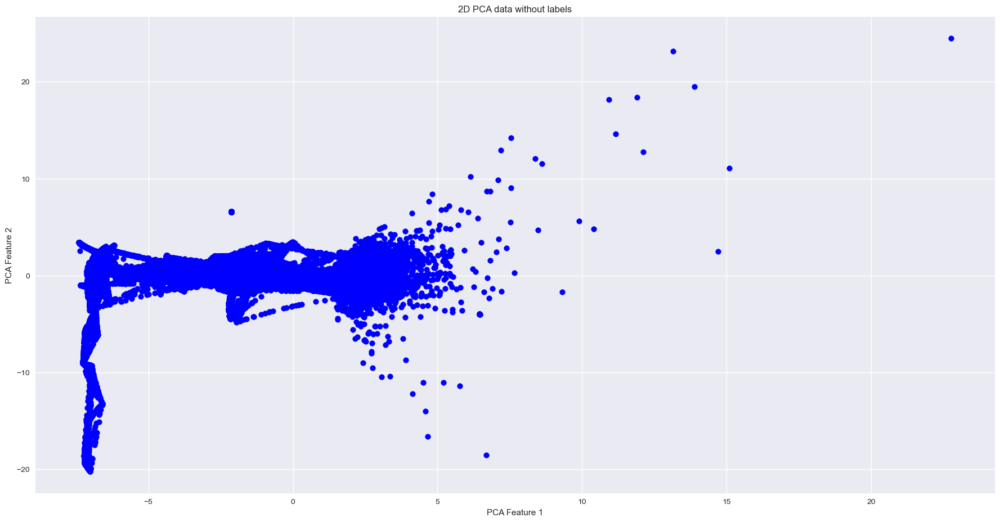

In [ ]:
import matplotlib.pyplot as plt

x1= X_test_pca2[:,0]
y1=X_test_pca2[:,1]
x2= X_train_pca2[:,0]
y2=X_train_pca2[:,1]

plt.scatter(x1, y1, c ="blue")
plt.xlabel('PCA Feature 1')
plt.ylabel('PCA Feature 2')
plt.title('2D PCA data without labels')

# To show the plot
plt.show()

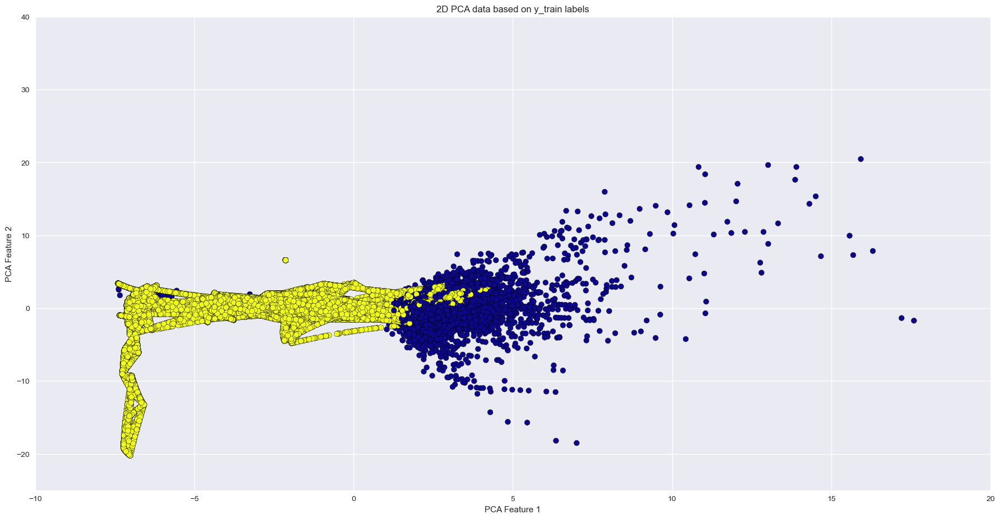

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Create a scatter plot with different colors based on labels
plt.scatter(x2, y2, c=y_train, cmap='plasma', marker='o', edgecolors='k')

# Set labels
plt.xlabel('PCA Feature 1')
plt.ylabel('PCA Feature 2')
plt.xlim(-10, 20)
plt.ylim(-25,40)

# Set title
plt.title('2D PCA data based on y_train labels')

# Show the plot
plt.show()

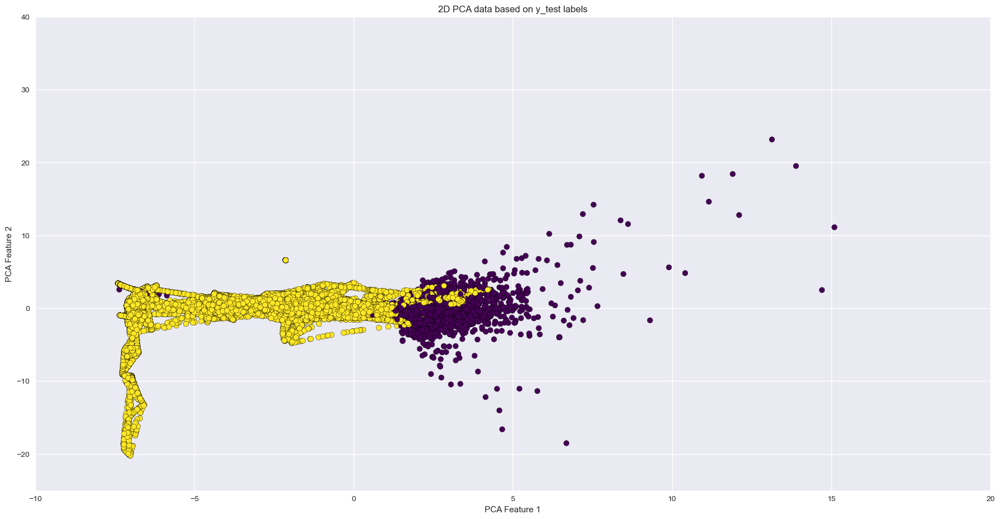

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Create a scatter plot with different colors based on labels
plt.scatter(x1, y1, c=y_test, cmap='viridis', marker='o', edgecolors='k')

# Set labels
plt.xlabel('PCA Feature 1')
plt.ylabel('PCA Feature 2')
plt.xlim(-10, 20)
plt.ylim(-25,40)

# Set title
plt.title('2D PCA data based on y_test labels')

# Show the plot
plt.show()

# 3D Visualization for clarity

In [ ]:
#creating a PCA object with 3 components
pca = PCA(n_components=3)

#tranforming the dataset
X_train_pca3 = pca.fit_transform(x_train)

#tranforming the dataset to 3 attributes
X_test_pca3 = pca.transform(x_test)

In [ ]:
x= X_test_pca3[:,0]
y=X_test_pca3[:,1]
z=X_test_pca3[:,2]

In [ ]:
df= pd.DataFrame({'feature1':x,'feature2':y,'feature3':z,'label': y_test})
df

,feature1,feature2,feature3,label
510747,2.124531,0.609260,-0.393407,1
390373,1.039700,-0.918155,-0.594677,1
81077,2.297153,-0.365920,0.201594,0
236854,2.168351,-0.538567,0.425764,0
407198,-4.239720,1.666684,1.158783,1
...,...,...,...,...
260738,2.661870,-0.502645,-0.371789,0
326576,-6.452418,2.781734,0.909098,1
498586,-6.948532,-4.096961,-0.097876,1
443122,2.205858,0.748732,-0.637522,1


In [ ]:
import plotly.express as px
fig = px.scatter_3d(df, x='feature1', y='feature2', z='feature3',color='label')
fig.show()

# 8. Applying Machine Learning Models on PCA transformed Data

## 8.1 Logistic Regression

In [ ]:
log_reg_pca= LogisticRegression()
start_time = time.time()

In [ ]:
log_reg_pca.fit(X_train_pca3, y_train)

LogisticRegression()

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 0.4274 seconds


In [ ]:
y_pred_pca = log_reg_pca.predict(X_test_pca3)

In [ ]:
print(classification_report(y_test, y_pred_pca))

              precision    recall  f1-score   support

           0       0.90      0.98      0.94     56863
           1       0.98      0.89      0.93     56863

    accuracy                           0.93    113726
   macro avg       0.94      0.93      0.93    113726
weighted avg       0.94      0.93      0.93    113726



## 8.2 Decision Trees

In [ ]:
dec_tree_pca= DecisionTreeClassifier()
start_time = time.time()

In [ ]:
dec_tree_pca.fit(x_train, y_train)

DecisionTreeClassifier()

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 27.8080 seconds


In [ ]:
y_pred_pca = dec_tree_pca.predict(x_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56863
           1       1.00      1.00      1.00     56863

    accuracy                           1.00    113726
   macro avg       1.00      1.00      1.00    113726
weighted avg       1.00      1.00      1.00    113726



## 8.3 Random Forest

In [ ]:
rand_forest_pca= RandomForestClassifier(n_estimators=50)
start_time = time.time()

In [ ]:
rand_forest_pca.fit(x_train, y_train)

RandomForestClassifier(n_estimators=50)

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 117.2076 seconds


In [ ]:
y_pred_pca = rand_forest_pca.predict(x_test)

In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56863
           1       1.00      1.00      1.00     56863

    accuracy                           1.00    113726
   macro avg       1.00      1.00      1.00    113726
weighted avg       1.00      1.00      1.00    113726



## 8.4 K Nearest Neighbor

In [ ]:
knn_pca = KNeighborsClassifier()
start_time = time.time()

In [ ]:
knn_pca.fit(x_train,y_train)

KNeighborsClassifier()

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 0.0558 seconds


In [ ]:
y_pred_pca = knn_pca.predict(x_test.values)

In [ ]:
print(classification_report(y_test, y_pred_pca))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56863
           1       1.00      1.00      1.00     56863

    accuracy                           1.00    113726
   macro avg       1.00      1.00      1.00    113726
weighted avg       1.00      1.00      1.00    113726



## 8.5 Support Vector Machines

In [ ]:
svm_svc_pca = svm.SVC()
start_time = time.time()

In [ ]:
svm_svc_pca.fit(x_train, y_train)

SVC()

In [ ]:
end_time = time.time()
training_time = end_time - start_time
print(f"Training Time: {training_time:.4f} seconds")

Training Time: 289.4226 seconds


In [ ]:
y_pred_svm_pca = svm_svc_pca.predict(x_test)

In [ ]:
print(classification_report(y_test, y_pred_svm_pca))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     56863
           1       1.00      1.00      1.00     56863

    accuracy                           1.00    113726
   macro avg       1.00      1.00      1.00    113726
weighted avg       1.00      1.00      1.00    113726



**Observations done after PCA**

* Logestic Regression model shows an accuracy of 0.93
* Decision Tree model shows an accuracy of 1.0
* Random Forest model shows an accuracy of 1.0
* Nearest Neighbor model shows an accuracy of 1.0
* SVM model shows an accuracy of 1.0

# 9. Data Quality vs Machine Learning Model

Accuracy on Noisy Data: 0.9158
Accuracy on Clean Data: 0.9653


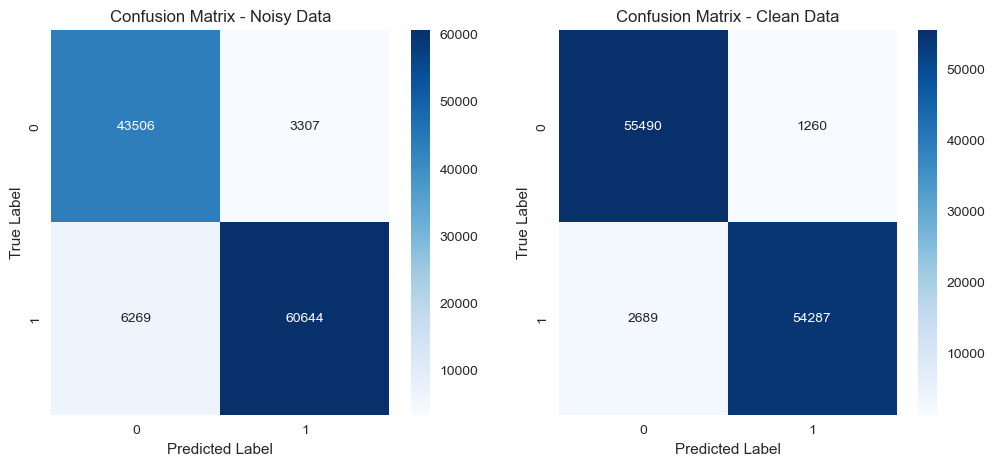

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

y = df['Class']

# Introduce noise to the labels
np.random.seed(42)
y_noisy = y.copy()
y_noisy[:50000] = 1 - y_noisy[:50000]

# Split the data into training and testing sets for both noisy and clean labels
X_train_noisy, X_test_noisy, y_train_noisy, y_test_noisy = train_test_split(X, y_noisy, test_size=0.2, random_state=42)
X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest model on the noisy data
model_noisy = RandomForestClassifier(n_estimators=5, random_state=42, n_jobs = -1)
model_noisy.fit(X_train_noisy, y_train_noisy)
y_pred_noisy = model_noisy.predict(X_test_noisy)

# Train a Random Forest model on the clean data
model_clean = LogisticRegression()
model_clean.fit(X_train_clean, y_train_clean)
y_pred_clean = model_clean.predict(X_test_clean)

# Calculate and print accuracy on both datasets
accuracy_noisy = accuracy_score(y_test_noisy, y_pred_noisy)
accuracy_clean = accuracy_score(y_test_clean, y_pred_clean)
print(f'Accuracy on Noisy Data Random Forest: {accuracy_noisy:.4f}')
print(f'Accuracy on Clean Data Logistic regression: {accuracy_clean:.4f}')

# Plot confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

sns.heatmap(confusion_matrix(y_test_noisy, y_pred_noisy), annot=True, fmt='d', cmap='Blues', ax=axes[0])
axes[0].set_title('Confusion Matrix - Noisy Data')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

sns.heatmap(confusion_matrix(y_test_clean, y_pred_clean), annot=True, fmt='d', cmap='Blues', ax=axes[1])
axes[1].set_title('Confusion Matrix - Clean Data')
axes[1].set_xlabel('Predicted Label')
axes[1].set_ylabel('True Label')

plt.show()

Accuracy on Noisy Data (MLP): 0.9045
Accuracy on Clean Data (Logistic Regression): 0.9653


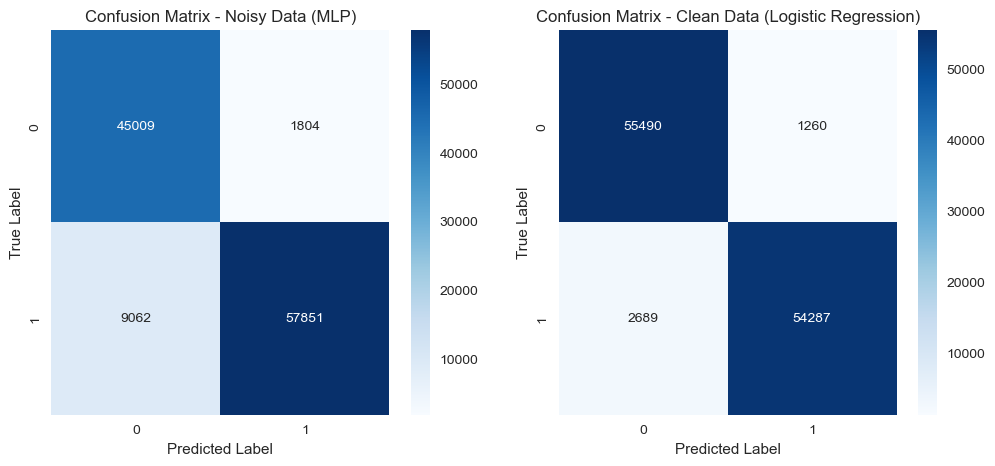

In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Introduce noise to the labels
np.random.seed(42)
y_noisy = y.copy()
y_noisy[:50000] = 1 - y_noisy[:50000]

# Split the data into training and testing sets for both noisy and clean labels
X_train_noisy, X_test_noisy, y_train_noisy, y_test_noisy = train_test_split(X, y_noisy, test_size=0.2, random_state=42)
X_train_clean, X_test_clean, y_train_clean, y_test_clean = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Multi-Layered Perceptron (MLP) model on the noisy data
model_noisy = MLPClassifier(hidden_layer_sizes=(5, ), max_iter=1000, random_state=42)
model_noisy.fit(X_train_noisy, y_train_noisy)
y_pred_noisy = model_noisy.predict(X_test_noisy)

# Train a Logistic Regression model on the clean data
model_clean = LogisticRegression()
model_clean.fit(X_train_clean, y_train_clean)
y_pred_clean = model_clean.predict(X_test_clean)

# Calculate and print accuracy on both datasets
accuracy_noisy = accuracy_score(y_test_noisy, y_pred_noisy)
accuracy_clean = accuracy_score(y_test_clean, y_pred_clean)
print(f'Accuracy on Noisy Data (MLP): {accuracy_noisy:.4f}')
print(f'Accuracy on Clean Data (Logistic Regression): {accuracy_clean:.4f}')

# Plot confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

sns.heatmap(confusion_matrix(y_test_noisy, y_pred_noisy), annot=True, fmt='d', cmap='Blues', ax=axes[0])
axes[0].set_title('Confusion Matrix - Noisy Data (MLP)')
axes[0].set_xlabel('Predicted Label')
axes[0].set_ylabel('True Label')

sns.heatmap(confusion_matrix(y_test_clean, y_pred_clean), annot=True, fmt='d', cmap='Blues', ax=axes[1])
axes[1].set_title('Confusion Matrix - Clean Data (Logistic Regression)')
axes[1].set_xlabel('Predicted Label')
axes[1].set_ylabel('True Label')

plt.show()

